# Introduction to FastAI

*   Package built on top of pytorch to make it faster and easier to train custom deep learning models

*   This demo walks through the process of training, cleaning, and analyzing a ResNet-18 convolution neural net using the FastAI python library









## Acknowledment:
The notebook borrows inspiration and code from the [Fastai course book](https://github.com/fastai/fastbook) by Jeremy Howard and Sylvain Gugger.

# Summary of model building process


*   Boston Globe photo dataset consists of a lot of photos of the Boston skyline or of people
*   Downloaded photos through Duck Duck Go that matched the term "skyline" and "person"
*   Used photos to tune a pre-trained convolution neural net model to classify images between skylines and people






### Sample thumbnails of the Boston photo dataset

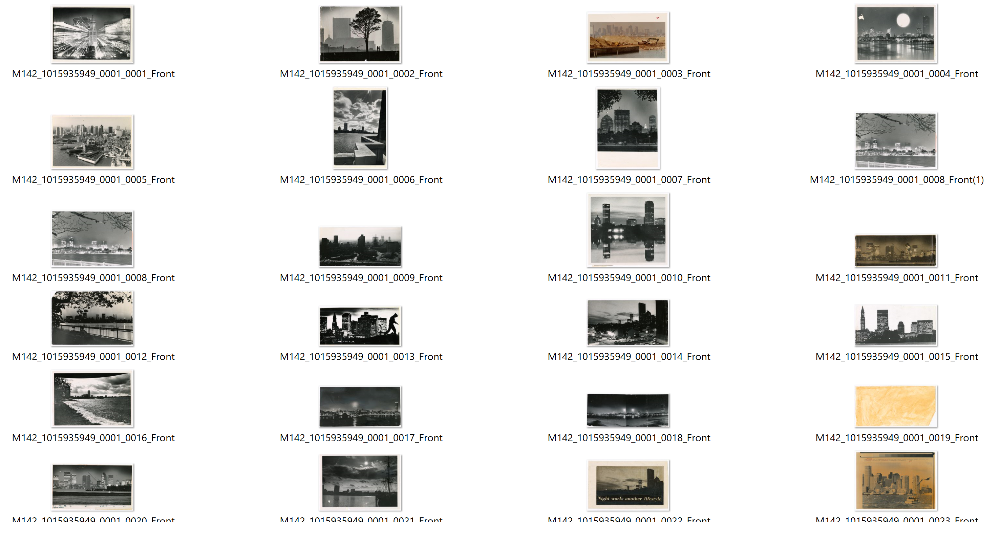

## Important Note: A GPU is necessary to train a deep learning model. 

Access a GPU in Google Collab by clicking the Runtime dropdown menu, then change runtime type, then change the Hardware accelerator to "GPU"

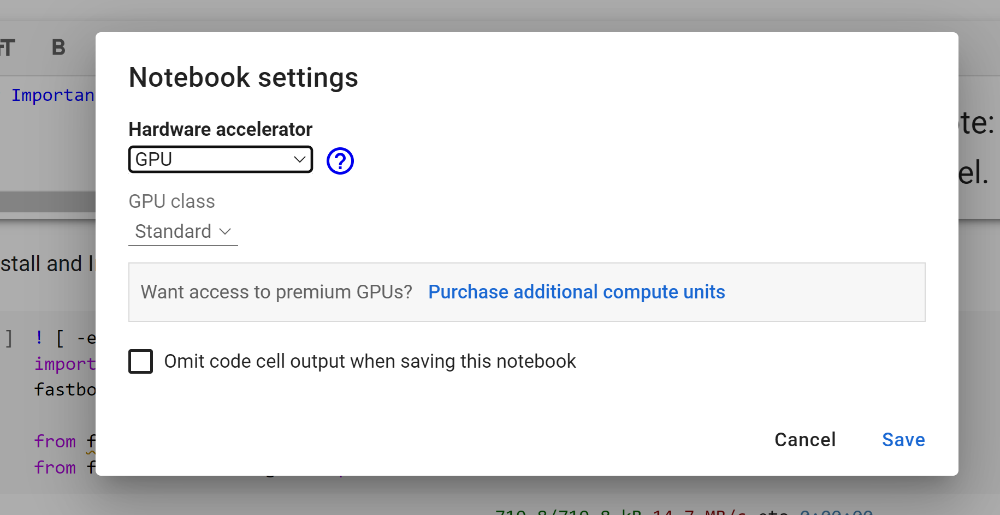

Install and Import fastbook and fastai libraries

In [ ]:
! [ -e /content ] && pip install -Uqq fastbook
import fastbook
fastbook.setup_book()

from fastbook import *
from fastai.vision.widgets import *

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 719.8/719.8 kB 14.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 53.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.0/7.0 MB 104.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 468.7/468.7 kB 44.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 132.9/132.9 kB 16.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 62.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 200.1/200.1 kB 24.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 110.5/110.5 kB 15.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 212.2/212.2 kB 26.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 83.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 264.6/264.6 kB 15.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 114.2/114.2 kB 16.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

Specify image class search terms and download photos through Duck Duck Go

In [ ]:

path = Path('image_class')
image_classes = "city skyline", "person"


if not path.exists():
    path.mkdir()
    for o in image_classes:
        dest = (path/o)
        dest.mkdir(exist_ok=True)
        results = search_images_ddg(f"{o}")
        download_images(dest, urls=results)

Remove any images (15 out of 374 images) from the dataset that failed to download properly

In [ ]:
fns = get_image_files(path)

failed = verify_images(fns)
print(len(failed))

failed.map(Path.unlink);

15


Create a "data block" and a "data loaders" object that get the images in a format to train the model

*   splits the dataset into training and validation sets
*   specifies the classes of the target variable (skyline and person)
*   resizes the images to 128 by 128 pixes





In [ ]:
skylines_datablock = DataBlock(
    blocks=(ImageBlock, CategoryBlock), 
    get_items=get_image_files, 
    splitter=RandomSplitter(valid_pct=0.2, seed=42),
    get_y=parent_label,
    item_tfms=Resize(128))

dls = skylines_datablock.dataloaders(path)

#recommended data transformation by FastAI developers
skylines_datablock = skylines_datablock.new(
    item_tfms=RandomResizedCrop(224, min_scale=0.5),
    batch_tfms=aug_transforms())
dls = skylines_datablock.dataloaders(path)

Example batch of images in the training data

/usr/local/lib/python3.9/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


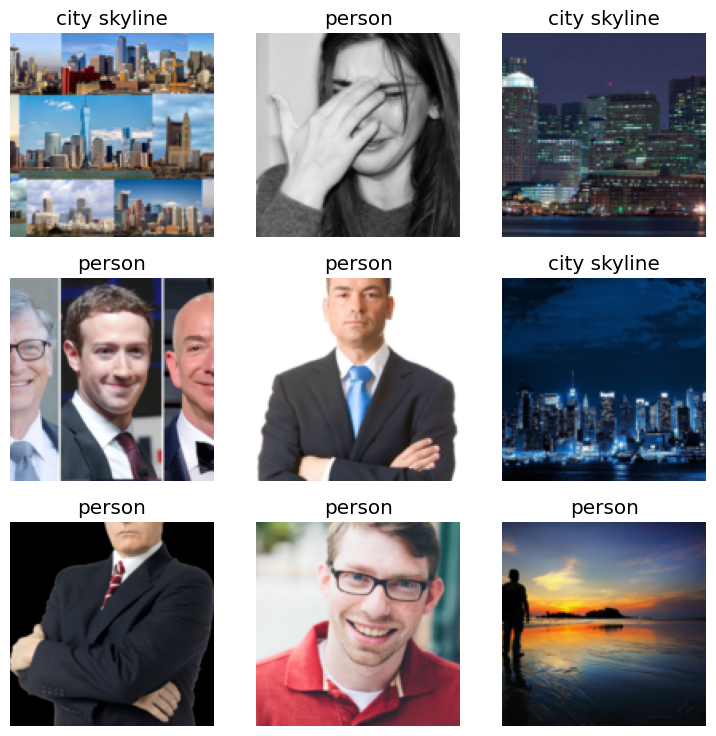

In [ ]:
dls.show_batch()

# Train the model

Create a learner object using a pretrained resnet18 CNN model. Tune the model with 5 epochs

In [ ]:
learn = vision_learner(dls, resnet18, metrics=error_rate)
learn.fine_tune(5)

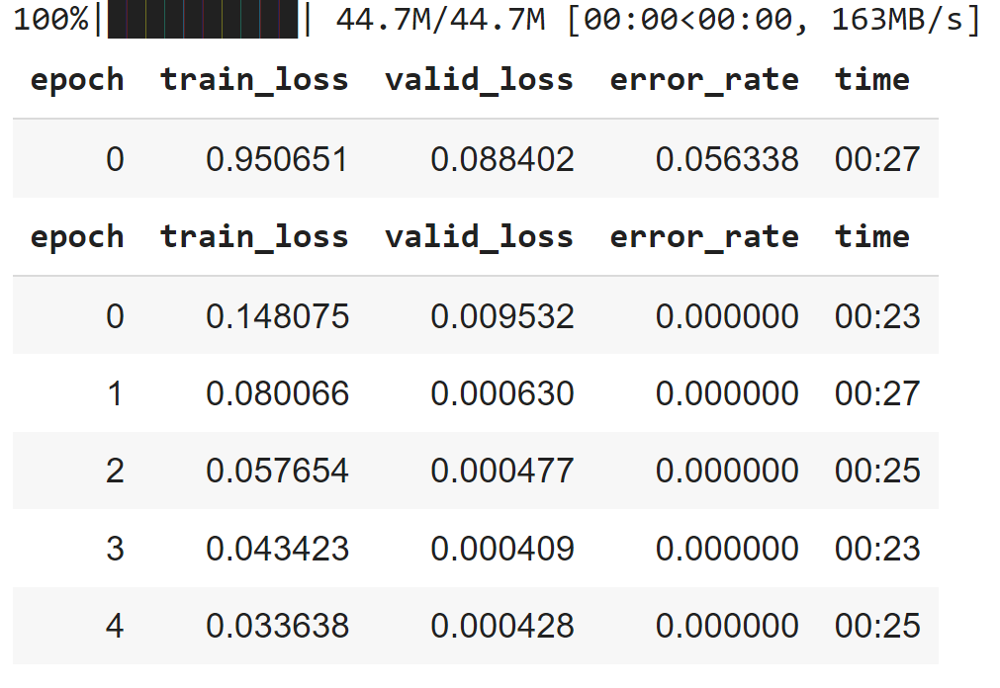

## Confusion matrix

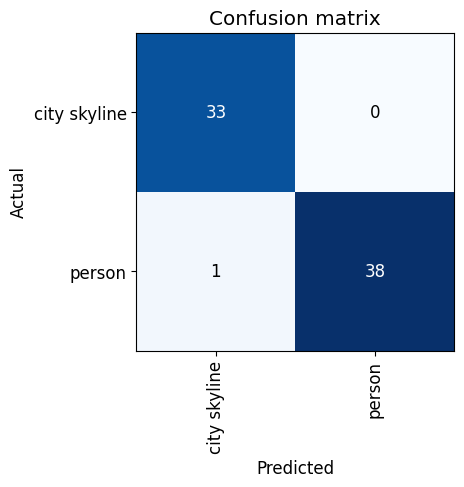

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

FastAI's cleaner function allows users to remove or relabel images from the dataset within the Jupyter notebook interface

In [ ]:
cleaner = ImageClassifierCleaner(learn)
cleaner

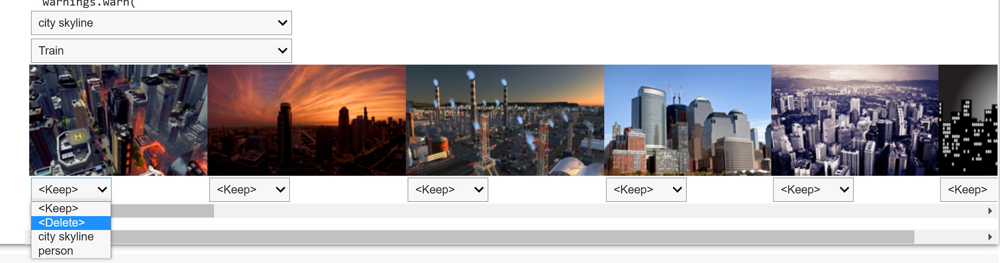

Once we have selected the images to be removed or relabeled, run the following to clean the dataset

In [ ]:
for idx in cleaner.delete(): cleaner.fns[idx].unlink()
for idx,cat in cleaner.change(): shutil.move(str(cleaner.fns[idx]), path/cat)

Show results of the model on predicting images in the validation set

In [ ]:
learn.show_results()

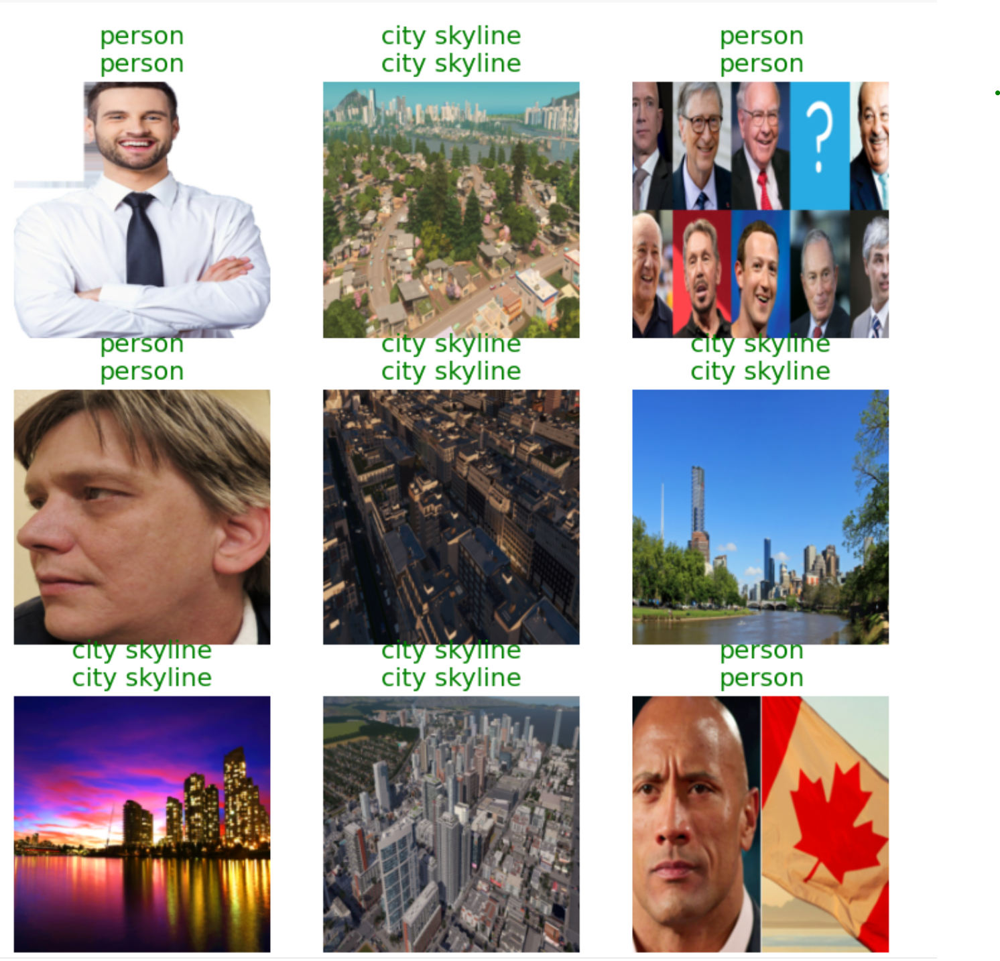

Export the model into a pickle file

In [ ]:
learn.export()


Now that the model is exported, we can switch the Google Colab runtime off of GPU and reimport the model here. Alternatively, we can import it to any other python environment without the need for a powerful GPU.



In [ ]:
path = Path()
path.ls(file_exts='.pkl')
learn_inf = load_learner(path/'export.pkl')

# Generate predictions on individual photos from the Boston dataset

Prediction includes probabilities between 0 and 1 that the image belongs to either of the two classes.

Upload any photos for which we want to generate a prediction to /content/ in google colab

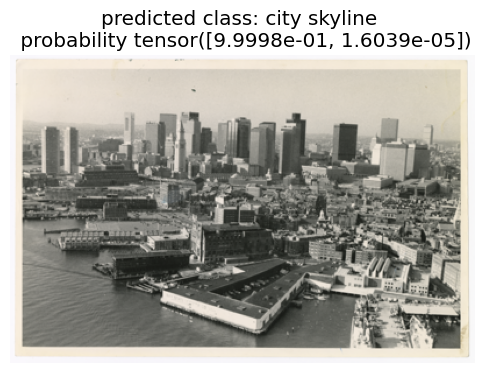

In [ ]:
from matplotlib import pyplot as plt
from matplotlib import image as mpimg

plt.rcParams['figure.figsize'] = [6, 6]
plt.rcParams.update({'font.size': 12})

#specify image file path
file_path = "/content/M142_1015935949_0001_0005_Front.tif"
prediction = learn_inf.predict(file_path)[0]
probability = learn_inf.predict(file_path)[2]
plt.title(f"predicted class: {prediction} \n probability {probability}")
 
image = mpimg.imread(file_path)
plt.imshow(image, cmap='gray')
plt.axis('off')
#plt.savefig("image_name")
plt.show()

### Additional examples of correctly predicted images from each class

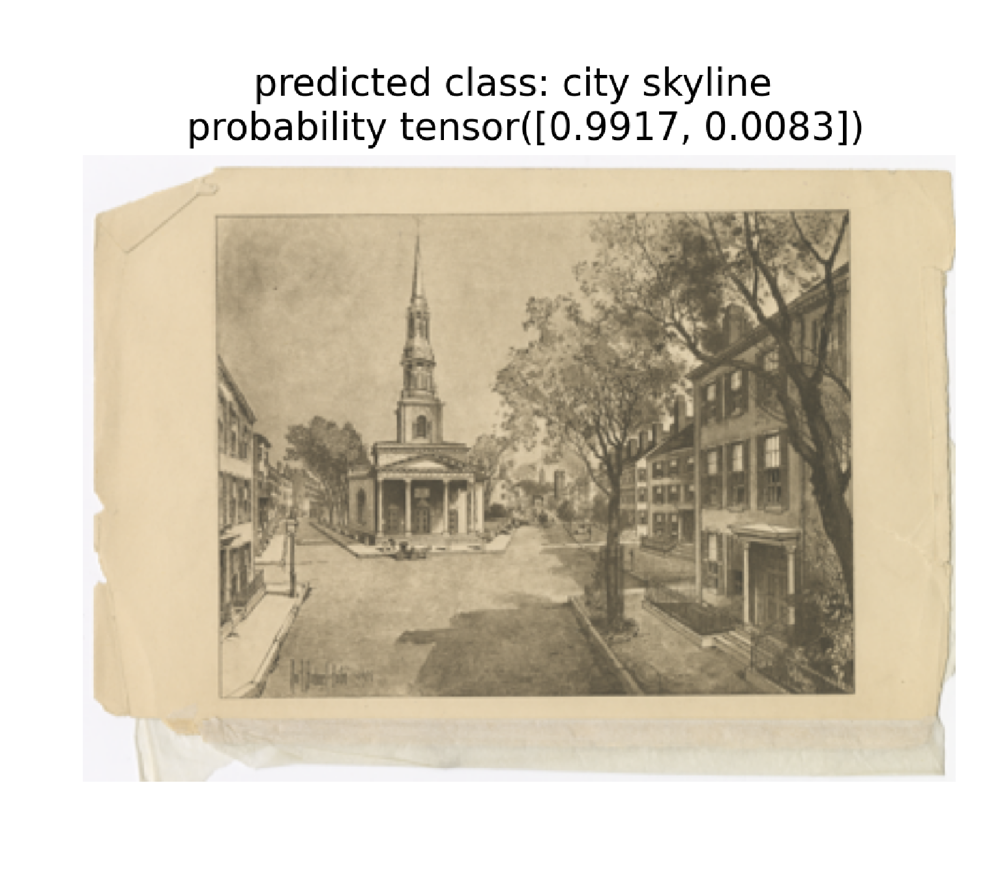

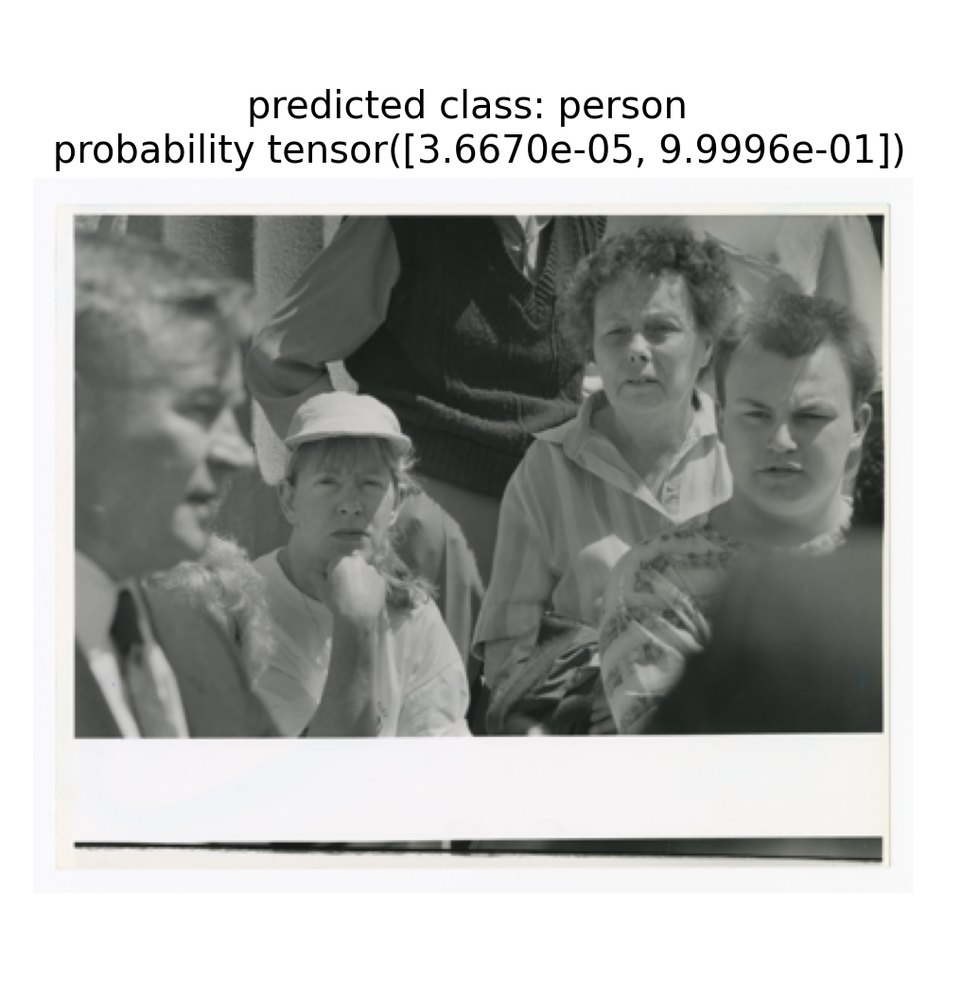

To generate predictions on multiple photos at once, upload all images to the /content/ folder in Google Collab and run the following:

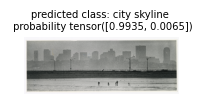

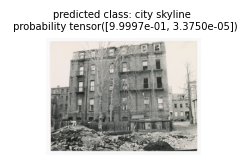

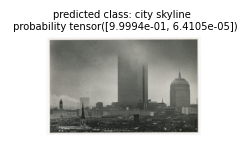

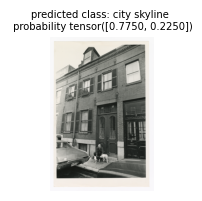

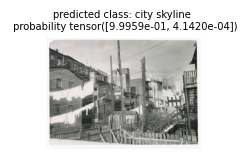

...

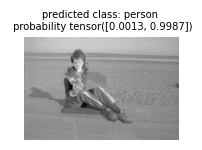

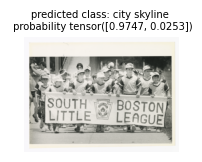

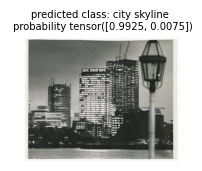

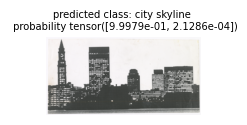

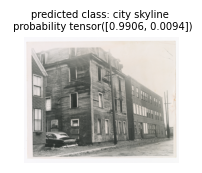

In [ ]:
plt.rcParams['figure.figsize'] = [2, 2]
plt.rcParams.update({'font.size': 6})

folder_dir = "/content/"
for image in os.listdir(folder_dir):
  prediction = learn_inf.predict(f"{folder_dir}{image}")[0]
  probability = learn_inf.predict(f"{folder_dir}{image}")[2]
  plt.title(f"predicted class: {prediction} \n probability {probability}")

  photo = mpimg.imread(f"{folder_dir}{image}")
  plt.imshow(photo, cmap='gray')
  plt.axis('off')
  #plt.savefig(f"preds/{image}")
  plt.show()

## Further analysis and data cleaning
Creating a pandas dataframe of the predictions, where each row has the predicted class, the name of the image, and the probability it belongs to each class. This allows for further analysis and cleaning of the predicted dataset. For example, if we wanted to remove or manually reclassify images that fall below a certain probability threshold, the dataframe allows for easy implementation. 

In [ ]:
import itertools
import pandas as pd

folder_dir = "/content/"
tensors = []
for image in os.listdir(folder_dir):
  prediction = learn_inf.predict(f"/content/{image}")
  tensors.append(list(prediction))

photos = [[i] for i in os.listdir(folder_dir)]
zipped = [list(e) for e in zip(tensors,photos)] 

list_tensors = []

for row in zipped:
  temp = list(itertools.chain.from_iterable(row))
  list_tensors.append(temp)

for pred in list_tensors:
  temp = pred[2].tolist()
  pred.append(temp)

df = pd.DataFrame(list_tensors, columns = ["prediction","tensor binary","tensorprobs","image_name","probs"])
df[['prob skyline','prob person']] = pd.DataFrame(df.probs.tolist(), index= df.index)

# Limitations

## There are two different ways that this model is limited:

1.   Incorrect classification
2.   Not enough classes






## Incorrect Classification

Although this model is remarkably accurate in its ability to correctly tell the difference between photos of buildings and people, it was not 100% accurate in classifying the images in the Boston photo subset. For example, below is an image of people classified as a city skyline.



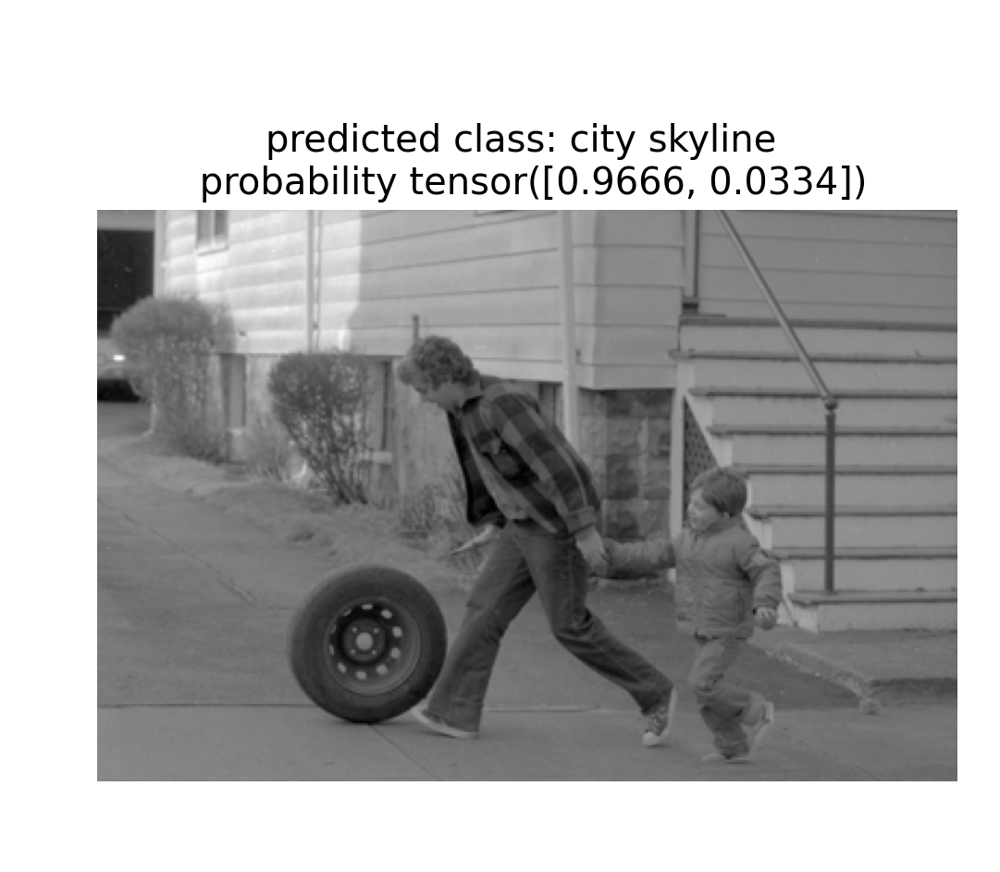

## Only two classes - no "other" class

The foremost limitation, however, is that the model only predicts between two classes, so every photo run through the model will be classified as a city skyline or person. Although those classes made up a sizeable majority of the Boston photos, the model as it currently exists is useless when it comes to classify other types of images.



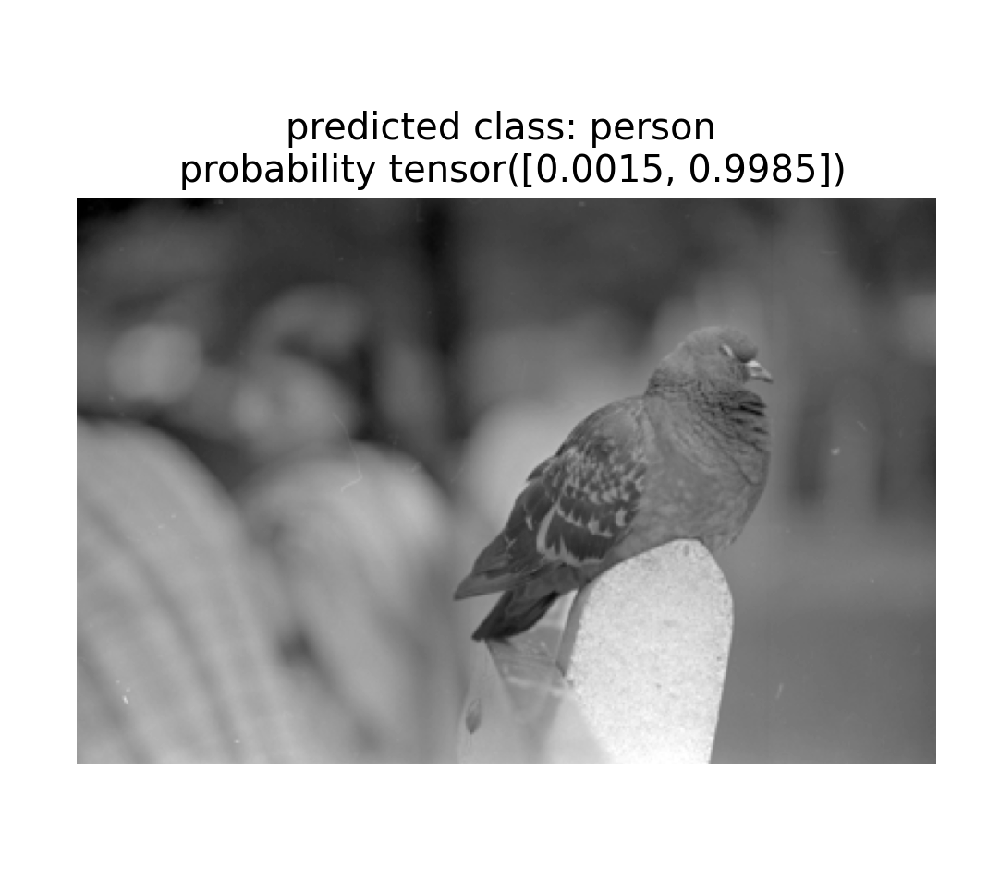

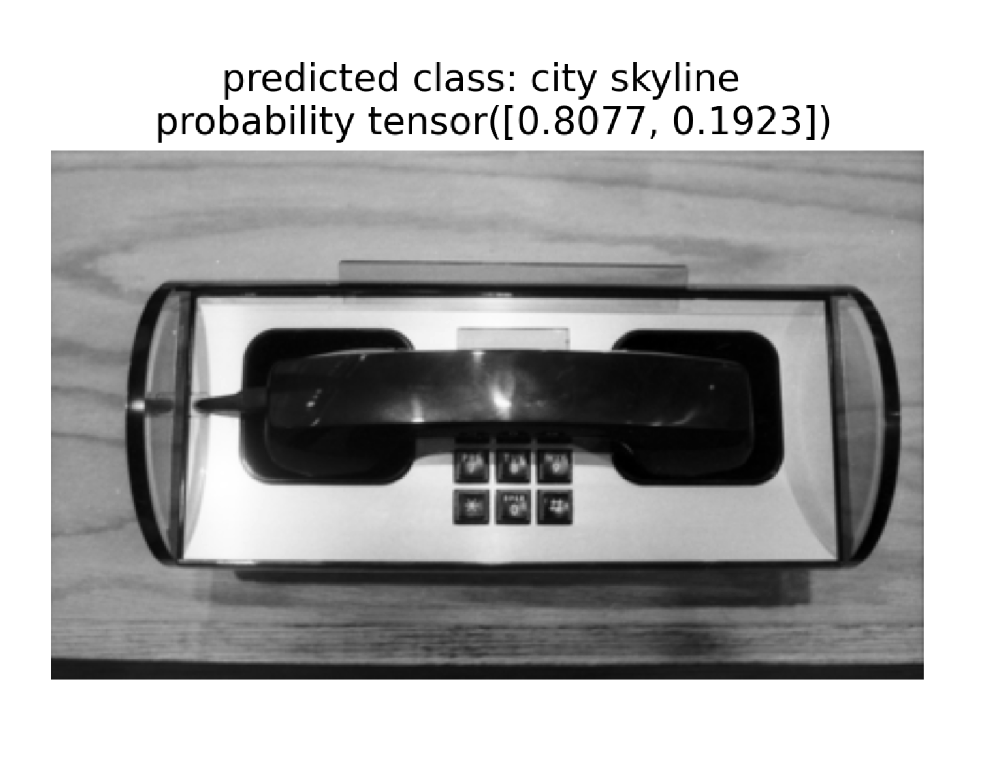

## Potential next steps

*   Add additional classes to the training dataset and retrain
*   Add an "other" class   






